In [2]:
DEBUG = False

In [3]:
import sys
sys.path.append('../HPA-competition-solutions/bestfitting/src/')

In [4]:
import time
import pretrainedmodels
import torchvision.models
import skimage.io
import numpy as np
import pandas as pd
import cv2
import PIL.Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SubsetRandomSampler, RandomSampler, SequentialSampler
from warmup_scheduler import GradualWarmupScheduler
from efficientnet_pytorch import model as enet
import albumentations
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import cohen_kappa_score
from tqdm import tqdm_notebook as tqdm
import os
import warnings
import cv2
from sklearn.metrics import average_precision_score
import pickle

warnings.filterwarnings('ignore') 

In [5]:
from config.config import *
from networks.densenet import *
from datasets.tool import *
from torch.utils.data import Dataset
import pandas as pd
import torchvision
import torch
import cv2
import os

import time
import shutil
from sklearn.metrics import f1_score

import torch
import torch.optim
from torch.utils.data import DataLoader
from torch.utils.data.sampler import RandomSampler, SequentialSampler
from torch.nn import DataParallel
from torch.backends import cudnn
import torch.nn.functional as F
from torch.autograd import Variable

from config.config import *
from utils.common_util import *
from networks.imageclsnet import init_network
from datasets.protein_dataset import ProteinDataset
from utils.augment_util import train_multi_augment2
from layers.loss import *
from layers.scheduler import *
from utils.log_util import Logger

run on pazur


In [6]:
kernel_type = 'pudae_xc1'

fold = 0
image_size = 1024
crop_size = 768
batch_size = 32
ITERS_TO_ACCUMULATE = 1
num_workers = 8
out_dim = 19
init_lr = 5e-4
nfold = 2 if DEBUG else 5
### ONE FOLD!!! ###
# nfold = 1
seed = 42
n_epochs = 3 if DEBUG else 6

device = torch.device('cuda')

In [7]:
df = pd.read_csv('../folds_updated.csv')
len(df)

48345

In [8]:
train_folder = '/media/darek/projects/hpa/hpa_train_full'
public__folder = '/media/darek/projects/hpa/hpa_public_full'

df_t = df[df.dataset == 'train']
df_p = df[df.dataset == 'public']
df_t['fpath'] = df_t.ID.apply(lambda r: os.path.join(train_folder, r))
df_p['fpath'] = df_p.ID.apply(lambda r: os.path.join(public__folder, r))

#DEBUG
# df_train = pd.concat([df_t, df_p], ignore_index=True)
# df_train = df_p
#DEBUG

df_train = pd.concat([df_t, df_p], ignore_index=True)
df_train.drop_duplicates(inplace=True)
df_train.reset_index(drop=True, inplace=True)
df_train['Label'] = df_train['Label'].astype(str)
df_train.head()

,ID,Label,dataset,fold,fpath
0,12d0e1dc-bbc7-11e8-b2bc-ac1f6b6435d0,14,train,4,/media/darek/projects/hpa/hpa_train_full/12d0e...
1,836a3fb4-bba5-11e8-b2ba-ac1f6b6435d0,14,train,0,/media/darek/projects/hpa/hpa_train_full/836a3...
2,5a474b22-bba5-11e8-b2ba-ac1f6b6435d0,5,train,1,/media/darek/projects/hpa/hpa_train_full/5a474...
3,a2a59eea-bba6-11e8-b2ba-ac1f6b6435d0,2,train,0,/media/darek/projects/hpa/hpa_train_full/a2a59...
4,d6118772-bba5-11e8-b2ba-ac1f6b6435d0,16|10|13,train,0,/media/darek/projects/hpa/hpa_train_full/d6118...


In [9]:
df_train = df_train.sample(256).reset_index(drop=True) if DEBUG else df_train

In [10]:
labels = [str(i) for i in range(19)]
full_counts = {}
fsum = 0
for lbl in labels:
    count = 0
    for row_label in df_train['Label']:
        if lbl in row_label.split('|'): count += 1
    full_counts[lbl] = count
    fsum += count
full_counts['avg'] = int(fsum/(len(labels)))

counts = list(zip(full_counts.keys(), full_counts.values()))
counts = np.array(sorted(counts, key=lambda x:-x[1]))
counts = pd.DataFrame(counts, columns=['label', 'full_count'])
counts.set_index('label', inplace=True)
counts.T

label,0,17,13,14,16,18,7,2,avg,4,12,5,6,3,9,1,10,8,15,11
full_count,8797,6710,6304,5952,5685,5316,4280,3934,3474,3204,2590,2589,2212,1845,1682,1607,1537,1320,312,141


## Model

In [11]:
class AttentionInceptionV3(nn.Module):
    def __init__(self, num_classes=28, attention_size=8, aux_attention_size=8):
        super().__init__()
        self.num_classes = num_classes
        self.cnn = torchvision.models.inception_v3(pretrained=False)
        self.attention_size = attention_size
        self.aux_attention_size = aux_attention_size

        conv = self.cnn.Conv2d_1a_3x3.conv
        self.cnn.Conv2d_1a_3x3.conv = nn.Conv2d(in_channels=4,
                                                out_channels=conv.out_channels,
                                                kernel_size=conv.kernel_size,
                                                stride=conv.stride,
                                                padding=conv.padding,
                                                bias=conv.bias)

        # copy pretrained weights
        self.cnn.Conv2d_1a_3x3.conv.weight.data[:,:3,:,:] = conv.weight.data
        self.cnn.Conv2d_1a_3x3.conv.weight.data[:,3:,:,:] = conv.weight.data[:,:1,:,:]

        self.features_a = nn.Sequential(
            self.cnn.Conv2d_1a_3x3,
            self.cnn.Conv2d_2a_3x3,
            self.cnn.Conv2d_2b_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2),
            self.cnn.Conv2d_3b_1x1,
            self.cnn.Conv2d_4a_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2),
            self.cnn.Mixed_5b,
            self.cnn.Mixed_5c,
            self.cnn.Mixed_5d,
            self.cnn.Mixed_6a,
            self.cnn.Mixed_6b,
            self.cnn.Mixed_6c,
            self.cnn.Mixed_6d,
            self.cnn.Mixed_6e,
        )

        self.features_b = nn.Sequential(
            self.cnn.Mixed_7a,
            self.cnn.Mixed_7b,
            self.cnn.Mixed_7c,
        )

        self.aux_avgpool = nn.AdaptiveAvgPool2d(self.aux_attention_size)
        aux_in_features = self.cnn.AuxLogits.fc.in_features
        self.aux_linear = nn.Conv2d(aux_in_features, self.num_classes, kernel_size=1, padding=0)
        self.aux_attention = nn.Conv2d(aux_in_features, self.num_classes, kernel_size=1, padding=0)

        self.avgpool = nn.AdaptiveAvgPool2d(self.attention_size)
        in_features = self.cnn.fc.in_features
        self.last_linear = nn.Conv2d(in_features, self.num_classes, kernel_size=1, padding=0)
        self.attention = nn.Conv2d(in_features, self.num_classes, kernel_size=1, padding=0)

    def forward(self, x):
        features_a = self.features_a(x)
#         print(features_a.shape)
        if self.training:
            if self.aux_attention_size != features_a.size(-1):
                aux_features = self.aux_avgpool(features_a)
            else:
                aux_features = features_a
            aux_logits = self.aux_linear(aux_features)
            assert aux_logits.size(1) == self.num_classes and \
                   aux_logits.size(2) == self.aux_attention_size and \
                   aux_logits.size(3) == self.aux_attention_size
            aux_logits_attention = self.aux_attention(aux_features)
            assert aux_logits_attention.size(1) == self.num_classes and \
                   aux_logits_attention.size(2) == self.aux_attention_size and \
                   aux_logits_attention.size(3) == self.aux_attention_size
            aux_logits_attention = aux_logits_attention.view(
                -1, self.num_classes,
                self.aux_attention_size * self.aux_attention_size)
            aux_attention = F.softmax(aux_logits_attention, dim=2)
            aux_attention = aux_attention.view(
                -1, self.num_classes, self.aux_attention_size, self.aux_attention_size)
            aux_logits = aux_logits * aux_attention
            aux_logits = aux_logits.view(
                -1, self.num_classes,
                self.aux_attention_size * self.aux_attention_size).sum(2).view(-1, self.num_classes)

        features_b = self.features_b(features_a)
#         print(features_b.shape)

        if self.aux_attention_size != features_b.size(-1):
            features_b = self.avgpool(features_b)
        logits = self.last_linear(features_b)
#         print(logits.shape)

        assert logits.size(1) == self.num_classes and \
               logits.size(2) == self.attention_size and \
               logits.size(3) == self.attention_size

        logits_attention = self.attention(features_b)
        assert logits_attention.size(1) == self.num_classes and \
               logits_attention.size(2) == self.attention_size and \
               logits_attention.size(3) == self.attention_size
        logits_attention = logits_attention.view(-1, self.num_classes, self.attention_size * self.attention_size)
        attention = F.softmax(logits_attention, dim=2)
        attention = attention.view(-1, self.num_classes, self.attention_size, self.attention_size)

        logits = logits * attention
        logits = logits.view(-1, self.num_classes, self.attention_size * self.attention_size).sum(2).view(-1, self.num_classes)
        if self.training:
            return logits, aux_logits
        return logits

In [12]:
model = AttentionInceptionV3(num_classes=19, attention_size=22, aux_attention_size=46)
inp = torch.zeros((1,4,768,768))
model.train()
out = model(inp)
out[0].shape, out[1].shape

(torch.Size([1, 19]), torch.Size([1, 19]))

In [13]:
ls ../pudae_models/inceptionv3.attention.policy.per_image_norm.1024/checkpoint/swa.10.027.pth

../pudae_models/inceptionv3.attention.policy.per_image_norm.1024/checkpoint/swa.10.027.pth


In [14]:
def get_model():
    
    num_classes=19
    model = AttentionInceptionV3(num_classes=19, attention_size=22, aux_attention_size=46)
    
    model_file = '../pudae_models/inceptionv3.attention.policy.per_image_norm.1024/checkpoint/swa.10.027.pth'
    weights = torch.load(model_file)
    pretrained_dict = weights['state_dict']
    model_dict = model.state_dict()

    # 1. filter out unnecessary keys
    pretrained_dict = {k: v for k, v in pretrained_dict.items() if k not in [
        'last_linear.weight', 'last_linear.bias', 'aux_linear.weight', \
        'aux_linear.bias', 'attention.weight', 'attention.bias', 'aux_attention.weight', 'aux_attention.bias']}
    # 2. overwrite entries in the existing state dict
    model_dict.update(pretrained_dict)
    # 3. load the new state dict
    model.load_state_dict(model_dict)

    i = 0
    for child in model.cnn.children():
        if i < 20:
            for param in child.parameters():
                param.requires_grad = False
        i += 1
    return model

In [15]:
def get_model_test():
    model = AttentionInceptionV3(num_classes=19, attention_size=22, aux_attention_size=46)
    return model

In [16]:
def open_rgby(fpath, yellow=True): #a function that reads RGBY image    
    if yellow: colors = ['red','green','blue','yellow']
    else: colors = ['red','green','blue']
    flags = cv2.IMREAD_GRAYSCALE
    img = [cv2.imread(fpath+'_'+color+'.png', flags) for color in colors]
    
    return np.stack(img, axis=-1)

## Dataset

In [17]:
class HPADataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        fpath = row.fpath
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        mean = np.mean(image.reshape(-1, 4), axis=0)
        std = np.std(image.reshape(-1, 4), axis=0)
        image -= mean
        image /= (std + 0.0000001)
        image = image.transpose(2, 0, 1)

        label = np.zeros(out_dim).astype(np.float32)
        img_lbls = [int(x) for x in row.Label.split('|')]
        for i in img_lbls: label[i] = 1.
        return torch.tensor(image), torch.tensor(label)

## Augmentations

In [18]:
from albumentations.core.transforms_interface import ImageOnlyTransform

class Gridify(ImageOnlyTransform):

    def __init__(
        self,
        grid_size=2048,
        always_apply=False,
        p=1.0,
    ):
        super(Gridify, self).__init__(always_apply, p)
        self.grid_size = grid_size
        self.transform = albumentations.Compose([
            albumentations.VerticalFlip(p=0.5),
            albumentations.HorizontalFlip(p=0.5),
        ])

    def apply(self, image, **params):
        grid = np.zeros((self.grid_size,self.grid_size, 4)).astype(np.uint8)
        ch,cw,_ = image.shape
        gh,gw,_ = grid.shape
        hsteps = np.ceil(gh/ch).astype(int)
        wsteps = np.ceil(gw/cw).astype(int)

        h,w = ch,cw
        hmargin = ch

        for i in range(hsteps):
            wmargin = cw
            h = ch * (i+1)
            if h > gh:
                hmargin = gh-h
                h = gh
            for j in range(wsteps):
                transformed = self.transform(image=image)
                transformed_image = transformed["image"]
                w = cw * (j+1)
                if w > gw:
                    wmargin = gw-w
                    w = gw
                grid[ch*i:h,cw*j:w,:] = transformed_image[:hmargin,:wmargin,:]
        return grid        

    def get_transform_init_args_names(self):
        return ("grid_size")

In [19]:
mean = [0.074598, 0.050630, 0.050891, 0.076287]#rgby
std =  [0.122813, 0.085745, 0.129882, 0.119411]


transforms_train = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
    albumentations.RandomCrop(crop_size, crop_size, p=1.),
    albumentations.VerticalFlip(p=0.5),
    albumentations.HorizontalFlip(p=0.5),
    albumentations.RandomRotate90(p=0.5),
])

transforms_val = albumentations.Compose([
    albumentations.Resize(image_size, image_size, p=1.),
])

transforms_grid1 = albumentations.Compose([
    Gridify(grid_size=2048),
    albumentations.Resize(image_size, image_size, p=1.),
])
transforms_grid2 = albumentations.Compose([
    Gridify(grid_size=1728),
    albumentations.Resize(image_size, image_size, p=1.),
])
transforms_grid3 = albumentations.Compose([
    Gridify(grid_size=3072),
    albumentations.Resize(image_size, image_size, p=1.),
])

In [20]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std
    def __call__(self, tensor):
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
        return torch.clamp(tensor,0.,1.)

In [21]:
def tensor2label(t):
    l = t.numpy().tolist()
    l = [i for i,v in enumerate(l) if v==1.]
    return str(l)
label = torch.tensor(np.array([1.,0,1,0]))
tensor2label(label)

'[0, 2]'

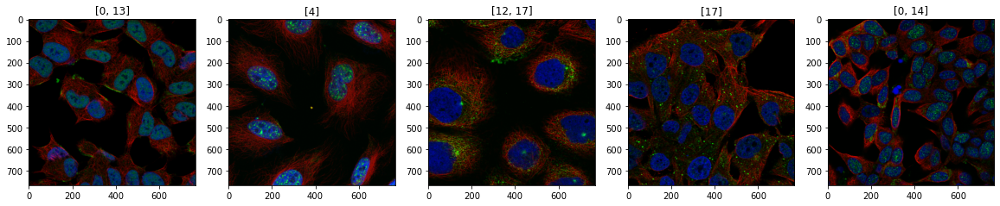

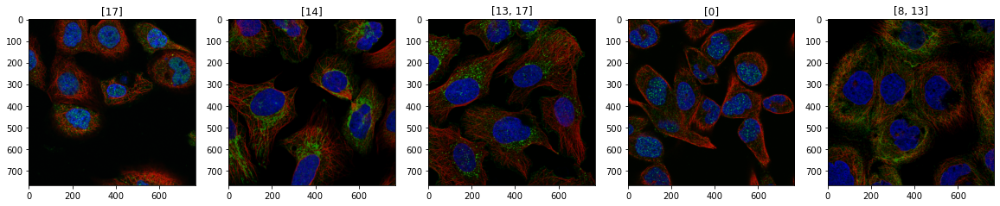

In [22]:
unnorm = UnNormalize(mean, std)
dataset_show = HPADataset(df_train, transform=transforms_train)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img, label = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[p].set_title(tensor2label(label))


## Loss

In [23]:
class FocalLoss(nn.Module):
    def __init__(self, gamma=2):
        super().__init__()
        self.gamma = gamma
        
    def forward(self, inputs, target):
        if not (target.size() == inputs.size()):
            raise ValueError("Target size ({}) must be the same as input size ({})"
                             .format(target.size(), input.size()))

        max_val = (-inputs).clamp(min=0)
        loss = inputs - inputs * target + max_val + \
            ((-max_val).exp() + (-inputs - max_val).exp()).log()

        invprobs = F.logsigmoid(-inputs * (target * 2.0 - 1.0))
        loss = (invprobs * self.gamma).exp() * loss
        
        return loss.sum(dim=1).mean()

In [24]:
criterion = FocalLoss().cuda()

## Train and Val

In [25]:
def train_epoch(loader, optimizer, scaler):

    model.train()
    train_loss = []
    bar = tqdm(loader)
    for i, (data, target) in enumerate(bar):
        
        data, target = data.to(device), target.to(device)
        loss_func = criterion
        
        
        with torch.cuda.amp.autocast():
            logits, aux_logits = model(data)
            loss = loss_func(logits, target)
            aux_loss = loss_func(aux_logits, target)
            loss = loss + 0.4 * aux_loss
            loss = loss / ITERS_TO_ACCUMULATE
                        
        scaler.scale(loss).backward()
        
        if (i + 1) % ITERS_TO_ACCUMULATE == 0:      
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()
        
        loss_np = loss.detach().cpu().numpy()
        train_loss.append(loss_np)
        smooth_loss = sum(train_loss[-100:]) / min(len(train_loss), 100)
        bar.set_description('loss: %.5f, smth: %.5f' % (loss_np, smooth_loss))
    return train_loss


def val_epoch(loader, get_output=False):

    model.eval()
    val_loss = []
    val_focal = []
    LOGITS = []
    PREDS = []
    TARGETS = []

    with torch.no_grad():
        for (data, target) in tqdm(loader):
            data, target = data.to(device), target.to(device)
            logits = model(data)
            loss = criterion(logits, target)
            pred = logits.sigmoid().detach()
            LOGITS.append(logits)
            PREDS.append(pred)
            TARGETS.append(target)
            val_loss.append(loss.detach().cpu().numpy())

        val_loss = np.mean(val_loss)

    LOGITS = torch.cat(LOGITS).cpu().numpy()
    PREDS = torch.cat(PREDS).cpu().numpy()
    TARGETS = torch.cat(TARGETS).cpu().numpy()
    
    average_precision = dict()
    for i in range(out_dim):
        average_precision[i] = average_precision_score(TARGETS[:, i], PREDS[:, i])
    average_precision["macro"] = average_precision_score(TARGETS, PREDS, average="macro")
    
    print('Average precision:')
    print(average_precision)

    if get_output:
        return LOGITS
    else:
        return val_loss, average_precision["macro"], average_precision

## Run Training

In [26]:
checkpoints = []
  
for fold in range(nfold):

    print('#'*60)
    print(f'Training fold {fold}')
    print('#'*60)

    train_idx = np.where((df_train['fold'] != fold))[0]
    valid_idx = np.where((df_train['fold'] == fold))[0]

    df_this  = df_train.loc[train_idx]
    df_valid = df_train.loc[valid_idx]

    dataset_train = HPADataset(df_this, transform=transforms_train)
    dataset_valid = HPADataset(df_valid, transform=transforms_val)

    train_loader = torch.utils.data.DataLoader(dataset_train, batch_size=batch_size, sampler=RandomSampler(dataset_train), num_workers=num_workers)
    valid_loader = torch.utils.data.DataLoader(dataset_valid, batch_size=batch_size, sampler=SequentialSampler(dataset_valid), num_workers=num_workers)

    model = get_model()
    model = model.to(device)

    scaler = torch.cuda.amp.GradScaler()

    optimizer = optim.Adam(model.parameters(), lr=init_lr)
    scheduler = lr_scheduler.CosineAnnealingLR(optimizer, n_epochs, eta_min=1e-5)

    print(len(dataset_train), len(dataset_valid))

    for epoch in range(1, n_epochs+1):
        print(time.ctime(), 'Epoch:', epoch)
        checkpoint_file = f'{kernel_type}_model_fold_{fold}_epoch_{epoch}.pth'

        if epoch == 2:
            for param in model.parameters():
                param.requires_grad = True
            print('Unfreezing!')


        train_loss = train_epoch(train_loader, optimizer, scaler)
        val_loss, aps, apsdict = val_epoch(valid_loader)
        scheduler.step()

        content = time.ctime() + ' ' + f'Epoch {epoch}, lr: {optimizer.param_groups[0]["lr"]:.7f}, train loss: {np.mean(train_loss):.5f}, val loss: {np.mean(val_loss):.5f}, aps: {(aps):.5f}'
        print(content)
        with open(f'log_{kernel_type}.txt', 'a') as appender:
            appender.write(content + '\n')

        torch.save(model.state_dict(), checkpoint_file)

        res = {
            'checkpoint': checkpoint_file,
            'val_loss': val_loss,
            'aps': aps,
            'aps_dict': apsdict,
            'seed': seed,
            'fold': fold,
            'epoch': epoch,
        }
        checkpoints.append(res)
            

############################################################
Training fold 0
############################################################
38227 10118
Sun May  9 01:56:02 2021 Epoch: 1


  0%|          | 0/1195 [00:00<?, ?it/s]

  0%|          | 0/317 [00:00<?, ?it/s]

Average precision:
{0: 0.8508211485218071, 1: 0.9156593195001055, 2: 0.883299826886101, 3: 0.8083593380970765, 4: 0.9343141705738545, 5: 0.8198145524126911, 6: 0.8376442934719639, 7: 0.8970421217967174, 8: 0.8644360306522129, 9: 0.8362722202602789, 10: 0.9441716840687628, 11: 0.10958293180098681, 12: 0.7922319038001798, 13: 0.8709656886240239, 14: 0.9564078265117271, 15: 0.6407568576639202, 16: 0.6067688006254106, 17: 0.7980435078720468, 18: 0.7894924051825661, 'macro': 0.797688664648549}
Sun May  9 02:15:55 2021 Epoch 1, lr: 0.0004672, train loss: 0.85325, val loss: 0.52159, aps: 0.79769
Sun May  9 02:15:55 2021 Epoch: 2
Unfreezing!


  0%|          | 0/1195 [00:00<?, ?it/s]

  0%|          | 0/317 [00:00<?, ?it/s]

Average precision:
{0: 0.8886940452024966, 1: 0.902303442200972, 2: 0.9121622283196592, 3: 0.8309304339167717, 4: 0.9449627500241178, 5: 0.847920155131714, 6: 0.8313319559655549, 7: 0.9000886342941601, 8: 0.8560975088134972, 9: 0.8322039581987759, 10: 0.9428734249328292, 11: 0.3450473229766452, 12: 0.8323149969006937, 13: 0.8838195818694194, 14: 0.9494446145733564, 15: 0.6041641141327603, 16: 0.6780546091973779, 17: 0.848189663853978, 18: 0.8943174159075603, 'macro': 0.8276274134953863}
Sun May  9 02:39:05 2021 Epoch 2, lr: 0.0003775, train loss: 0.60281, val loss: 0.49891, aps: 0.82763
Sun May  9 02:39:05 2021 Epoch: 3


  0%|          | 0/1195 [00:00<?, ?it/s]

  0%|          | 0/317 [00:00<?, ?it/s]

Average precision:
{0: 0.8817457415232565, 1: 0.9292674884775871, 2: 0.9149540399597419, 3: 0.8426187037065075, 4: 0.9399248324188423, 5: 0.8415964326705485, 6: 0.8508400661123452, 7: 0.9084531866542467, 8: 0.9000976974277324, 9: 0.8711163262311264, 10: 0.9562765313977086, 11: 0.4476639296624321, 12: 0.851184143141314, 13: 0.8883013352741328, 14: 0.9622955447254461, 15: 0.7459115429252601, 16: 0.6866404136829347, 17: 0.8647975866439817, 18: 0.8989783270944084, 'macro': 0.8517191510383975}
Sun May  9 03:02:17 2021 Epoch 3, lr: 0.0002550, train loss: 0.53745, val loss: 0.44096, aps: 0.85172
Sun May  9 03:02:17 2021 Epoch: 4


  0%|          | 0/1195 [00:00<?, ?it/s]

  0%|          | 0/317 [00:00<?, ?it/s]

Average precision:
{0: 0.8939725265603741, 1: 0.9334362541484719, 2: 0.9155628557667265, 3: 0.8472368640234943, 4: 0.9449818774689419, 5: 0.8411915527356837, 6: 0.8646127724600624, 7: 0.9102244946137577, 8: 0.9016909597176642, 9: 0.8658425433037111, 10: 0.9590484634268754, 11: 0.4700389294400225, 12: 0.8536327641532865, 13: 0.8867050329917183, 14: 0.965784703019692, 15: 0.7425660653586718, 16: 0.6970686142714444, 17: 0.868427486207684, 18: 0.9034376636336923, 'macro': 0.8560769696474724}
Sun May  9 03:25:29 2021 Epoch 4, lr: 0.0001325, train loss: 0.48752, val loss: 0.45802, aps: 0.85608
Sun May  9 03:25:29 2021 Epoch: 5


  0%|          | 0/1195 [00:00<?, ?it/s]

  0%|          | 0/317 [00:00<?, ?it/s]

Average precision:
{0: 0.8976495460577874, 1: 0.9361263062971642, 2: 0.9215320788663655, 3: 0.8628176073015941, 4: 0.9455993327730056, 5: 0.8523030985341249, 6: 0.8618300014509317, 7: 0.9154869926143687, 8: 0.9063722066339953, 9: 0.8689183445635774, 10: 0.9596176807611199, 11: 0.4675435686501339, 12: 0.8531044058797064, 13: 0.8936213691673757, 14: 0.9627787646320367, 15: 0.754564842331626, 16: 0.7222475914344606, 17: 0.8763554932229014, 18: 0.9186045272494783, 'macro': 0.8619512504432503}
Sun May  9 03:48:44 2021 Epoch 5, lr: 0.0000428, train loss: 0.44709, val loss: 0.42063, aps: 0.86195
Sun May  9 03:48:44 2021 Epoch: 6


  0%|          | 0/1195 [00:00<?, ?it/s]

  0%|          | 0/317 [00:00<?, ?it/s]

Average precision:
{0: 0.9032912921955447, 1: 0.9382694266868327, 2: 0.9220794952056275, 3: 0.8599452909129681, 4: 0.9487767423001714, 5: 0.857284834547212, 6: 0.8693198564779392, 7: 0.9202415568408372, 8: 0.9068043396400274, 9: 0.8786998825121065, 10: 0.9615122393193788, 11: 0.45651610824828254, 12: 0.8592955798340417, 13: 0.8969507920282512, 14: 0.9663607589143252, 15: 0.7485246857032637, 16: 0.7288975686578205, 17: 0.8799449665432593, 18: 0.9244602576060711, 'macro': 0.864588193377577}
Sun May  9 04:11:54 2021 Epoch 6, lr: 0.0000100, train loss: 0.41324, val loss: 0.41841, aps: 0.86459
############################################################
Training fold 1
############################################################
38704 9641
Sun May  9 04:11:55 2021 Epoch: 1


  0%|          | 0/1210 [00:00<?, ?it/s]

  0%|          | 0/302 [00:00<?, ?it/s]

Average precision:
{0: 0.8597397297714277, 1: 0.9182123578590176, 2: 0.8727294436562412, 3: 0.8732821244688163, 4: 0.9239271264159868, 5: 0.8194244541760272, 6: 0.7986430990417702, 7: 0.8960239857192407, 8: 0.850529435122899, 9: 0.8337120966399876, 10: 0.9609091558188548, 11: 0.14564490736625682, 12: 0.7838494378191005, 13: 0.8614480638986977, 14: 0.9513081765828545, 15: 0.5144486648712806, 16: 0.6388757304640915, 17: 0.7908476564526278, 18: 0.8222270870623531, 'macro': 0.7955675122740807}
Sun May  9 04:31:34 2021 Epoch 1, lr: 0.0004672, train loss: 0.84943, val loss: 0.55334, aps: 0.79557
Sun May  9 04:31:34 2021 Epoch: 2
Unfreezing!


  0%|          | 0/1210 [00:00<?, ?it/s]

  0%|          | 0/302 [00:00<?, ?it/s]

Average precision:
{0: 0.8878125473171277, 1: 0.9256923084723794, 2: 0.8875773670370449, 3: 0.876599725274821, 4: 0.9277470034595008, 5: 0.8214138187193031, 6: 0.829964114472737, 7: 0.901945855699295, 8: 0.8752387123858656, 9: 0.828692732963791, 10: 0.9754747281795021, 11: 0.5865254381261028, 12: 0.8208037396357121, 13: 0.8669625040356552, 14: 0.9533390586090319, 15: 0.5421079202214858, 16: 0.6630920857058512, 17: 0.8279724336268572, 18: 0.8775812808548311, 'macro': 0.8356075460419419}
Sun May  9 04:54:41 2021 Epoch 2, lr: 0.0003775, train loss: 0.59871, val loss: 0.45617, aps: 0.83561
Sun May  9 04:54:41 2021 Epoch: 3


  0%|          | 0/1210 [00:00<?, ?it/s]

  0%|          | 0/302 [00:00<?, ?it/s]

Average precision:
{0: 0.8834431160327962, 1: 0.9201968872064138, 2: 0.8938083804766846, 3: 0.8588701747813763, 4: 0.9384421140138851, 5: 0.8323900213032529, 6: 0.835745512221561, 7: 0.902365860465973, 8: 0.8725137876568987, 9: 0.8456164089040642, 10: 0.9757430547815327, 11: 0.5602864242713114, 12: 0.8356537068942766, 13: 0.8732946827744774, 14: 0.9564426995907886, 15: 0.5640382458661692, 16: 0.6925124193162929, 17: 0.8494152487920844, 18: 0.8941206714298372, 'macro': 0.841310495619983}
Sun May  9 05:17:46 2021 Epoch 3, lr: 0.0002550, train loss: 0.53387, val loss: 0.45746, aps: 0.84131
Sun May  9 05:17:46 2021 Epoch: 4


  0%|          | 0/1210 [00:00<?, ?it/s]

  0%|          | 0/302 [00:00<?, ?it/s]

Average precision:
{0: 0.8965686316175528, 1: 0.9148062282302525, 2: 0.899432807799635, 3: 0.8741832809066489, 4: 0.9411542011143393, 5: 0.8262048972706498, 6: 0.8180823736210114, 7: 0.9102863118530131, 8: 0.8843005200444994, 9: 0.859628537085299, 10: 0.981124771228837, 11: 0.5944596145509907, 12: 0.8145172008217151, 13: 0.8771354127744914, 14: 0.956651596022303, 15: 0.5869095726017602, 16: 0.7044321272296971, 17: 0.8556232042312721, 18: 0.9075831471201078, 'macro': 0.8475307597960039}
Sun May  9 05:40:52 2021 Epoch 4, lr: 0.0001325, train loss: 0.48300, val loss: 0.44098, aps: 0.84753
Sun May  9 05:40:53 2021 Epoch: 5


  0%|          | 0/1210 [00:00<?, ?it/s]

  0%|          | 0/302 [00:00<?, ?it/s]

Average precision:
{0: 0.8970370949802522, 1: 0.9270615883298841, 2: 0.9028083333817613, 3: 0.8860588414870313, 4: 0.9383137656546328, 5: 0.8330725900448004, 6: 0.8384250896733324, 7: 0.9101373228121477, 8: 0.8990834258890821, 9: 0.8561382468506984, 10: 0.9809541060529348, 11: 0.5946074975403892, 12: 0.823783147198833, 13: 0.8876010099863546, 14: 0.9634246306054104, 15: 0.5813180131925119, 16: 0.7094630392229304, 17: 0.8660060234777085, 18: 0.9050767734191897, 'macro': 0.8526510810420994}
Sun May  9 06:04:00 2021 Epoch 5, lr: 0.0000428, train loss: 0.44136, val loss: 0.43772, aps: 0.85265
Sun May  9 06:04:00 2021 Epoch: 6


  0%|          | 0/1210 [00:00<?, ?it/s]

  0%|          | 0/302 [00:00<?, ?it/s]

Average precision:
{0: 0.9047563285510989, 1: 0.9224208809813793, 2: 0.9021258725474255, 3: 0.8880216367882251, 4: 0.9406070327123988, 5: 0.845780103929026, 6: 0.8380785029882784, 7: 0.9089519232325121, 8: 0.9028360816583522, 9: 0.870511308396485, 10: 0.9826699091182958, 11: 0.5854000842595035, 12: 0.8244115387965412, 13: 0.8917424552100379, 14: 0.9631341410756951, 15: 0.5733290949959386, 16: 0.718908126116746, 17: 0.8690241641585487, 18: 0.9201926323435351, 'macro': 0.8554158851505276}
Sun May  9 06:27:08 2021 Epoch 6, lr: 0.0000100, train loss: 0.41013, val loss: 0.44421, aps: 0.85542
############################################################
Training fold 2
############################################################
38577 9768
Sun May  9 06:27:09 2021 Epoch: 1


  0%|          | 0/1206 [00:00<?, ?it/s]

  0%|          | 0/306 [00:00<?, ?it/s]

Average precision:
{0: 0.8501718757519253, 1: 0.9544665901187397, 2: 0.8572199166435519, 3: 0.8341949250316507, 4: 0.9429321204658426, 5: 0.7763604821649931, 6: 0.8658969024459802, 7: 0.8933651719878569, 8: 0.9038951719709872, 9: 0.8384963310633863, 10: 0.9370315508488491, 11: 0.059767616728110845, 12: 0.7603896564054533, 13: 0.8401710019201489, 14: 0.9528240637903869, 15: 0.6776144380205714, 16: 0.6502001224214455, 17: 0.8150833588248507, 18: 0.8290654117943144, 'macro': 0.8020603530736339}
Sun May  9 06:46:54 2021 Epoch 1, lr: 0.0004672, train loss: 0.85186, val loss: 0.54650, aps: 0.80206
Sun May  9 06:46:54 2021 Epoch: 2
Unfreezing!


  0%|          | 0/1206 [00:00<?, ?it/s]

  0%|          | 0/306 [00:00<?, ?it/s]

Average precision:
{0: 0.8869641522754514, 1: 0.9474859307607216, 2: 0.88452040172193, 3: 0.8331048337501191, 4: 0.9460788703261337, 5: 0.7858231893031662, 6: 0.8745962154313139, 7: 0.9094152027048782, 8: 0.9036350516992796, 9: 0.8555751875320461, 10: 0.9650242689973233, 11: 0.3518862632962385, 12: 0.80092160375943, 13: 0.8583827435944774, 14: 0.9583006829137507, 15: 0.7385454045378003, 16: 0.6750480891347622, 17: 0.8645257582826789, 18: 0.9027947508228111, 'macro': 0.8390857158339111}
Sun May  9 07:10:01 2021 Epoch 2, lr: 0.0003775, train loss: 0.60077, val loss: 0.50600, aps: 0.83909
Sun May  9 07:10:01 2021 Epoch: 3


  0%|          | 0/1206 [00:00<?, ?it/s]

  0%|          | 0/306 [00:00<?, ?it/s]

Average precision:
{0: 0.891835748845832, 1: 0.948202032246652, 2: 0.9026643741160495, 3: 0.8689062574181255, 4: 0.9545273301560252, 5: 0.7877167372923664, 6: 0.8828713778893172, 7: 0.9038830525069458, 8: 0.9232923747183746, 9: 0.8476441636673977, 10: 0.9717847507198156, 11: 0.4940501893476517, 12: 0.8254133508060916, 13: 0.8630476652586022, 14: 0.9592727456421528, 15: 0.739550438119513, 16: 0.7079563332076116, 17: 0.8094552571098554, 18: 0.9071085393086288, 'macro': 0.852062248335632}
Sun May  9 07:33:10 2021 Epoch 3, lr: 0.0002550, train loss: 0.53531, val loss: 0.46043, aps: 0.85206
Sun May  9 07:33:10 2021 Epoch: 4


  0%|          | 0/1206 [00:00<?, ?it/s]

  0%|          | 0/306 [00:00<?, ?it/s]

Average precision:
{0: 0.8951785359449655, 1: 0.9502014832998203, 2: 0.9047245513113039, 3: 0.8704500555038215, 4: 0.955087645940468, 5: 0.7823671527598649, 6: 0.8803396837665156, 7: 0.9138765725763545, 8: 0.9324402677378082, 9: 0.8590095320444707, 10: 0.9739666413856369, 11: 0.49000373634469707, 12: 0.7947364074154796, 13: 0.8616528499681951, 14: 0.963899324836796, 15: 0.7330802452994158, 16: 0.7079198987870737, 17: 0.8728563117847026, 18: 0.9178733350677253, 'macro': 0.8557718016723745}
Sun May  9 07:56:17 2021 Epoch 4, lr: 0.0001325, train loss: 0.48842, val loss: 0.47473, aps: 0.85577
Sun May  9 07:56:17 2021 Epoch: 5


  0%|          | 0/1206 [00:00<?, ?it/s]

  0%|          | 0/306 [00:00<?, ?it/s]

Average precision:
{0: 0.9053019795158995, 1: 0.9538520846456578, 2: 0.9057598763238686, 3: 0.8791386984316253, 4: 0.9611362803195415, 5: 0.7909095534294458, 6: 0.8911017551714472, 7: 0.9140490322015178, 8: 0.9371774397309877, 9: 0.8681864474354127, 10: 0.9739559620028597, 11: 0.5082537423290311, 12: 0.8103838947502148, 13: 0.8677302568882062, 14: 0.9646331156157356, 15: 0.7417502757279093, 16: 0.7202485112835699, 17: 0.8798061290330424, 18: 0.9229424587225421, 'macro': 0.862964078608343}
Sun May  9 08:19:25 2021 Epoch 5, lr: 0.0000428, train loss: 0.44349, val loss: 0.44008, aps: 0.86296
Sun May  9 08:19:25 2021 Epoch: 6


  0%|          | 0/1206 [00:00<?, ?it/s]

  0%|          | 0/306 [00:00<?, ?it/s]

Average precision:
{0: 0.9054625184160532, 1: 0.9562401894307937, 2: 0.9072679824675431, 3: 0.8824636988905317, 4: 0.9601121231205394, 5: 0.795232923016841, 6: 0.8932805332446363, 7: 0.9196285831089666, 8: 0.9389326952303202, 9: 0.8681046560896926, 10: 0.9737830377098262, 11: 0.5009632163231885, 12: 0.8096825738459411, 13: 0.8675918459442336, 14: 0.9664119890791353, 15: 0.7522258260060884, 16: 0.7235672128363797, 17: 0.8844098298386186, 18: 0.923225880397193, 'macro': 0.8646624902629747}
Sun May  9 08:42:32 2021 Epoch 6, lr: 0.0000100, train loss: 0.41123, val loss: 0.43917, aps: 0.86466
############################################################
Training fold 3
############################################################
38838 9507
Sun May  9 08:42:33 2021 Epoch: 1


  0%|          | 0/1214 [00:00<?, ?it/s]

  0%|          | 0/298 [00:00<?, ?it/s]

Average precision:
{0: 0.855208836241371, 1: 0.9397576759270371, 2: 0.8602479376585797, 3: 0.8489724906005697, 4: 0.9458643245425608, 5: 0.796534574468544, 6: 0.844573962804754, 7: 0.8719415631347666, 8: 0.8675217184347305, 9: 0.8552754347109788, 10: 0.9404262302028451, 11: 0.11945203990306431, 12: 0.76361442132177, 13: 0.8570581038335385, 14: 0.9579522770880224, 15: 0.5515716385198147, 16: 0.6169279815293687, 17: 0.7878286048597701, 18: 0.8056484703431239, 'macro': 0.7940199097960637}
Sun May  9 09:02:17 2021 Epoch 1, lr: 0.0004672, train loss: 0.84310, val loss: 0.55271, aps: 0.79402
Sun May  9 09:02:17 2021 Epoch: 2
Unfreezing!


  0%|          | 0/1214 [00:00<?, ?it/s]

  0%|          | 0/298 [00:00<?, ?it/s]

Average precision:
{0: 0.8724329101975177, 1: 0.9446959848331806, 2: 0.8854898831797445, 3: 0.8465889618862902, 4: 0.9450730905911846, 5: 0.7704987662316313, 6: 0.8594178904154224, 7: 0.8850773046462862, 8: 0.8580829202640369, 9: 0.8539685330569048, 10: 0.964450894046288, 11: 0.5317466017183753, 12: 0.809019355284528, 13: 0.8606686365510504, 14: 0.9563103376229656, 15: 0.6393218896198973, 16: 0.6704230869391336, 17: 0.8187778035551709, 18: 0.8934325926791863, 'macro': 0.835025128595726}
Sun May  9 09:25:24 2021 Epoch 2, lr: 0.0003775, train loss: 0.59871, val loss: 0.52852, aps: 0.83503
Sun May  9 09:25:24 2021 Epoch: 3


  0%|          | 0/1214 [00:00<?, ?it/s]

  0%|          | 0/298 [00:00<?, ?it/s]

Average precision:
{0: 0.885591073020524, 1: 0.9538987870228398, 2: 0.8942300476424646, 3: 0.8670089502241134, 4: 0.9491977237804005, 5: 0.8154017719481548, 6: 0.8486616186009897, 7: 0.8817641535195104, 8: 0.8771028936500234, 9: 0.8730012877679052, 10: 0.9612244660304952, 11: 0.4320969095180998, 12: 0.7978244898427668, 13: 0.8643928214740495, 14: 0.9669324301625337, 15: 0.6459193370069802, 16: 0.7013273124879409, 17: 0.8374879630859939, 18: 0.8968625770761288, 'macro': 0.839469821782206}
Sun May  9 09:48:33 2021 Epoch 3, lr: 0.0002550, train loss: 0.53325, val loss: 0.46917, aps: 0.83947
Sun May  9 09:48:33 2021 Epoch: 4


  0%|          | 0/1214 [00:00<?, ?it/s]

  0%|          | 0/298 [00:00<?, ?it/s]

Average precision:
{0: 0.8972168245017847, 1: 0.9590624185089179, 2: 0.9030940170067226, 3: 0.8859737775201778, 4: 0.9544659509367194, 5: 0.8237716017177067, 6: 0.8576532086947027, 7: 0.8886907991677387, 8: 0.8993144250802855, 9: 0.8759082157059044, 10: 0.961854250006175, 11: 0.5257654698500193, 12: 0.8329508276073314, 13: 0.8747442458087842, 14: 0.966298983868715, 15: 0.6568060781494354, 16: 0.7154169516519455, 17: 0.8587530309125277, 18: 0.913116060171394, 'macro': 0.8553082703614203}
Sun May  9 10:11:42 2021 Epoch 4, lr: 0.0001325, train loss: 0.48380, val loss: 0.45083, aps: 0.85531
Sun May  9 10:11:42 2021 Epoch: 5


  0%|          | 0/1214 [00:00<?, ?it/s]

  0%|          | 0/298 [00:00<?, ?it/s]

Average precision:
{0: 0.9078040314776572, 1: 0.9609061725012044, 2: 0.9052796624952267, 3: 0.8918870767175489, 4: 0.9604684114405301, 5: 0.8282107158260582, 6: 0.8682176318699744, 7: 0.895782468631259, 8: 0.9051323824947868, 9: 0.8819651296978747, 10: 0.9637459679187588, 11: 0.4803130988387099, 12: 0.8164089016247118, 13: 0.8816170255927174, 14: 0.9671983974260647, 15: 0.6807562790992012, 16: 0.7257904509644729, 17: 0.8643413755720051, 18: 0.9186926745735037, 'macro': 0.8581325186716983}
Sun May  9 10:34:51 2021 Epoch 5, lr: 0.0000428, train loss: 0.44062, val loss: 0.41910, aps: 0.85813
Sun May  9 10:34:52 2021 Epoch: 6


  0%|          | 0/1214 [00:00<?, ?it/s]

  0%|          | 0/298 [00:00<?, ?it/s]

Average precision:
{0: 0.9083888299114549, 1: 0.9625833458668017, 2: 0.9059299604900394, 3: 0.8934432965221532, 4: 0.962086009924636, 5: 0.8406804400239906, 6: 0.8690378904810475, 7: 0.8979109206980328, 8: 0.903084013288473, 9: 0.8825306981649743, 10: 0.9644912141378084, 11: 0.5121693353820227, 12: 0.8241438930159454, 13: 0.8829545836141589, 14: 0.96872848258459, 15: 0.7005704664758449, 16: 0.7282300760261872, 17: 0.8672444364101436, 18: 0.9221618751676189, 'macro': 0.8629668299045223}
Sun May  9 10:58:04 2021 Epoch 6, lr: 0.0000100, train loss: 0.40827, val loss: 0.41882, aps: 0.86297
############################################################
Training fold 4
############################################################
39034 9311
Sun May  9 10:58:05 2021 Epoch: 1


  0%|          | 0/1220 [00:00<?, ?it/s]

  0%|          | 0/291 [00:00<?, ?it/s]

Average precision:
{0: 0.8541661542294233, 1: 0.9273349175066044, 2: 0.8462494254782896, 3: 0.8627107260228691, 4: 0.9354895589016706, 5: 0.7979570551906846, 6: 0.7871767950987352, 7: 0.8763610822777441, 8: 0.8676459482169431, 9: 0.8513876823531084, 10: 0.9358164334447389, 11: 0.03000115506666692, 12: 0.7758901462965256, 13: 0.8676706311981192, 14: 0.9524028023379421, 15: 0.7745590096835312, 16: 0.6261141680929025, 17: 0.7431734758799372, 18: 0.7740508985365233, 'macro': 0.7940083192533137}
Sun May  9 11:17:47 2021 Epoch 1, lr: 0.0004672, train loss: 0.84820, val loss: 0.56223, aps: 0.79401
Sun May  9 11:17:47 2021 Epoch: 2
Unfreezing!


  0%|          | 0/1220 [00:00<?, ?it/s]

  0%|          | 0/291 [00:00<?, ?it/s]

Average precision:
{0: 0.8693973514578626, 1: 0.9467230599620865, 2: 0.8836131460537876, 3: 0.8737834526150485, 4: 0.9431413571057929, 5: 0.7887544883261683, 6: 0.8141096793557773, 7: 0.8965402055416829, 8: 0.8877496829020363, 9: 0.8760247611626093, 10: 0.9677722003021584, 11: 0.3374404456473343, 12: 0.8018010550696553, 13: 0.8811233490683381, 14: 0.9572788783331178, 15: 0.8095843532353184, 16: 0.6802616687656355, 17: 0.79690523340467, 18: 0.8577478616838459, 'macro': 0.8352501173680488}
Sun May  9 11:40:56 2021 Epoch 2, lr: 0.0003775, train loss: 0.59564, val loss: 0.50322, aps: 0.83525
Sun May  9 11:40:56 2021 Epoch: 3


  0%|          | 0/1220 [00:00<?, ?it/s]

  0%|          | 0/291 [00:00<?, ?it/s]

Average precision:
{0: 0.8804588044405901, 1: 0.9374882247240672, 2: 0.8925557110539734, 3: 0.8847219972307591, 4: 0.9389417398998522, 5: 0.8122027482607169, 6: 0.8240912746147967, 7: 0.8895003081566496, 8: 0.8870801470282648, 9: 0.8716517923481971, 10: 0.9682410509671577, 11: 0.3876338218034959, 12: 0.8228309701729503, 13: 0.8754712009494089, 14: 0.9590483999836797, 15: 0.7920582108720851, 16: 0.6965614951799011, 17: 0.8080957300704245, 18: 0.8811380498964898, 'macro': 0.8426195619817611}
Sun May  9 12:04:04 2021 Epoch 3, lr: 0.0002550, train loss: 0.52924, val loss: 0.48068, aps: 0.84262
Sun May  9 12:04:04 2021 Epoch: 4


  0%|          | 0/1220 [00:00<?, ?it/s]

  0%|          | 0/291 [00:00<?, ?it/s]

Average precision:
{0: 0.8919591423435439, 1: 0.9528103672433227, 2: 0.8914182692545372, 3: 0.8847421940437742, 4: 0.9434334660922633, 5: 0.8313783221597987, 6: 0.8263016151101512, 7: 0.9048692610275905, 8: 0.9007907104638392, 9: 0.8731241049009812, 10: 0.9708330083938437, 11: 0.41759941801115613, 12: 0.8280078944035357, 13: 0.8924250490603268, 14: 0.9596057954232147, 15: 0.7982661448737168, 16: 0.7212317140306236, 17: 0.8282892041202637, 18: 0.9006489567810821, 'macro': 0.853564980933556}
Sun May  9 12:27:10 2021 Epoch 4, lr: 0.0001325, train loss: 0.48293, val loss: 0.44792, aps: 0.85356
Sun May  9 12:27:11 2021 Epoch: 5


  0%|          | 0/1220 [00:00<?, ?it/s]

  0%|          | 0/291 [00:00<?, ?it/s]

Average precision:
{0: 0.8954636717270041, 1: 0.9549459275671286, 2: 0.8946949369505032, 3: 0.8943570780426986, 4: 0.9413332136967208, 5: 0.8316669527694704, 6: 0.8264769240940975, 7: 0.8946924500875083, 8: 0.9053045500568563, 9: 0.8899652356865577, 10: 0.9730588926299558, 11: 0.4111416138960605, 12: 0.8128128453691287, 13: 0.8808904622426992, 14: 0.9591265070523661, 15: 0.7976652136155876, 16: 0.7187621403289202, 17: 0.8267608917471088, 18: 0.9011410081489802, 'macro': 0.8531716060899658}
Sun May  9 12:50:17 2021 Epoch 5, lr: 0.0000428, train loss: 0.43916, val loss: 0.44346, aps: 0.85317
Sun May  9 12:50:17 2021 Epoch: 6


  0%|          | 0/1220 [00:00<?, ?it/s]

  0%|          | 0/291 [00:00<?, ?it/s]

Average precision:
{0: 0.9000510011375209, 1: 0.9597258060509046, 2: 0.9023353230095177, 3: 0.8961727659349924, 4: 0.9421933739374392, 5: 0.8311204829621077, 6: 0.8295705503412173, 7: 0.8987933769112132, 8: 0.9142507847729427, 9: 0.8949955073186144, 10: 0.9707497365240735, 11: 0.4030247773436493, 12: 0.8292577798219201, 13: 0.890832828700887, 14: 0.9607658467167335, 15: 0.7996872286477517, 16: 0.7249522720716676, 17: 0.8278049407915106, 18: 0.9047444487096141, 'macro': 0.8568962543002251}
Sun May  9 13:13:24 2021 Epoch 6, lr: 0.0000100, train loss: 0.40869, val loss: 0.45600, aps: 0.85690


In [27]:
checkpoint_df = pd.DataFrame(checkpoints)

In [28]:
checkpoint_df.to_csv('checkpoints.csv', index=False)

In [29]:
means = pd.DataFrame()
means['aps'] = checkpoint_df.groupby('epoch')['aps'].mean()
means['val_loss'] = checkpoint_df.groupby('epoch')['val_loss'].mean()
means

,aps,val_loss
epoch,,
1,0.796669,0.547274
2,0.834519,0.498566
3,0.845436,0.461740
4,0.853651,0.454494
5,0.857774,0.432198
6,0.860906,0.435324


## Test Inference

In [30]:
test_image_folder = '/media/darek/projects/hpa/testrgby/test_cells/test_cells'
test_df = pd.read_csv('/media/darek/projects/hpa/testrgby/test_cell_df.csv')
test_df.head()

,image_id,cell_id,size1,size2,enc
0,0040581b-f1f2-4fbe-b043-b6bfea5404bb,1,342,1050,eNqtVm2PojAQ/ksMZe+Sy21yubtc4gKDIkpBUJQ3KyD//9...
1,0040581b-f1f2-4fbe-b043-b6bfea5404bb,2,762,680,eNrVUm1PwkAM/kvt3XgRjEajvO7uhGCEEHCgcSQi/v9vXt...
2,0040581b-f1f2-4fbe-b043-b6bfea5404bb,3,398,470,eNoLCEgJMg4wDMg3NPQ39Df2NfaF0EZ+IBoBIXzc8oSgAR...
3,0040581b-f1f2-4fbe-b043-b6bfea5404bb,4,372,344,eNptUstOAzEM/CUnXtoiAQcegnbzOMAFgdRFbIXEpf9/q+...
4,0040581b-f1f2-4fbe-b043-b6bfea5404bb,5,544,244,eNp9UcuSmzAQ/CVGku1U8CGpxBs7EsMrPNdgMNYasIH/v0...


In [31]:
test_df = test_df.sample(64).reset_index(drop=True) if DEBUG else test_df

In [32]:
len(test_df)

10716

In [33]:
class HPATestDataset(Dataset):
    def __init__(self, df, transform=None):
        self.df = df.reset_index(drop=True)
        self.transform = transform

    def __len__(self):
        return self.df.shape[0]

    def __getitem__(self, index):
        row = self.df.iloc[index]
        img_id = row.image_id
        cell_id = row.cell_id
        cell_image_id = str(img_id) + '_' + str(cell_id)
        fpath = os.path.join(test_image_folder, cell_image_id)
        image = open_rgby(fpath)

        if self.transform is not None:
            image = self.transform(image=image)['image']
        image = image.astype(np.float32)
        mean = np.mean(image.reshape(-1, 4), axis=0)
        std = np.std(image.reshape(-1, 4), axis=0)
        image -= mean
        image /= (std + 0.0000001)
        image = image.transpose(2, 0, 1)

        return torch.tensor(image)

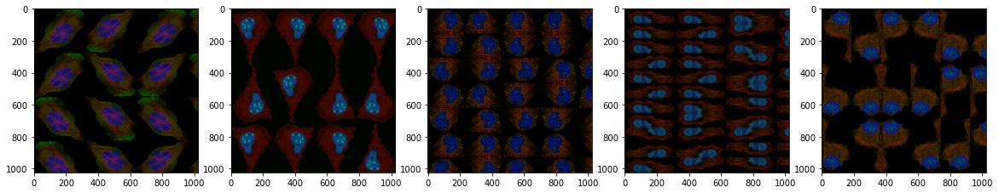

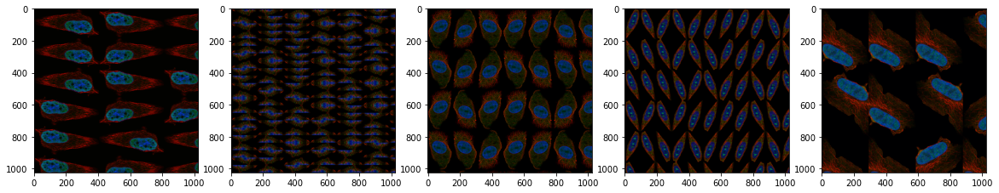

In [34]:
dataset_show = HPATestDataset(test_df, transform=transforms_grid1)
from pylab import rcParams
rcParams['figure.figsize'] = 20,10
for i in range(2):
    f, axarr = plt.subplots(1,5)
    for p in range(5):
        idx = np.random.randint(0, len(dataset_show))
        img = dataset_show[idx]
        img = unnorm(img)[:3,:,:]
        axarr[p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())

In [35]:
dataset1 = HPATestDataset(test_df, transform=transforms_grid1)
loader1 = DataLoader(dataset1, batch_size=batch_size, num_workers=num_workers, shuffle=False)

dataset2 = HPATestDataset(test_df, transform=transforms_grid2)
loader2 = DataLoader(dataset2, batch_size=batch_size, num_workers=num_workers, shuffle=False)

dataset3 = HPATestDataset(test_df, transform=transforms_grid3)
loader3 = DataLoader(dataset3, batch_size=batch_size, num_workers=num_workers, shuffle=False)

loaders = [loader1]

In [36]:
model_dir = '.'

In [37]:
def load_models(model_files):
    models = []
    for model_f in model_files:
        model_f = os.path.join(model_dir, model_f)
        model = get_model_test()
        model.load_state_dict(torch.load(model_f, map_location=lambda storage, loc: storage), strict=True)
        model.eval()
        model.to(device)
        models.append(model)
        print(f'{model_f} loaded!')
    return models

model_files = []

epoch_eval = 3

flds = nfold
# single fold:
flds = 1

for fold in range(flds):
    mf = f'{kernel_type}_model_fold_{fold}_epoch_{epoch_eval}.pth'
    model_files.append(mf)

models = load_models(model_files)

./pudae_xc1_model_fold_0_epoch_3.pth loaded!


In [38]:
ALL_FOLDS = []

with torch.no_grad():
    for model in tqdm(models):
        ALL_TTA = []
        for loader in loaders:            
            LOGITS = []
            for data in tqdm(loader):
                data = data.to(device)
                logits = model(data)
                LOGITS.append(logits)
            LOGITS = torch.cat(LOGITS).sigmoid().cpu()
            ALL_TTA.append(LOGITS)
        ALL_FOLDS.append(ALL_TTA)

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/335 [00:00<?, ?it/s]

In [39]:
AVG_TTA = [sum(TTA) / len(TTA) for TTA in ALL_FOLDS]
AVG_LOGITS = sum(AVG_TTA) / len(AVG_TTA)

In [40]:
AVG_LOGITS.shape

torch.Size([10716, 19])

In [41]:
with open('logits_3from5_epochs_gridify_fold0.pickle', 'wb') as handle:
    pickle.dump(AVG_LOGITS, handle)

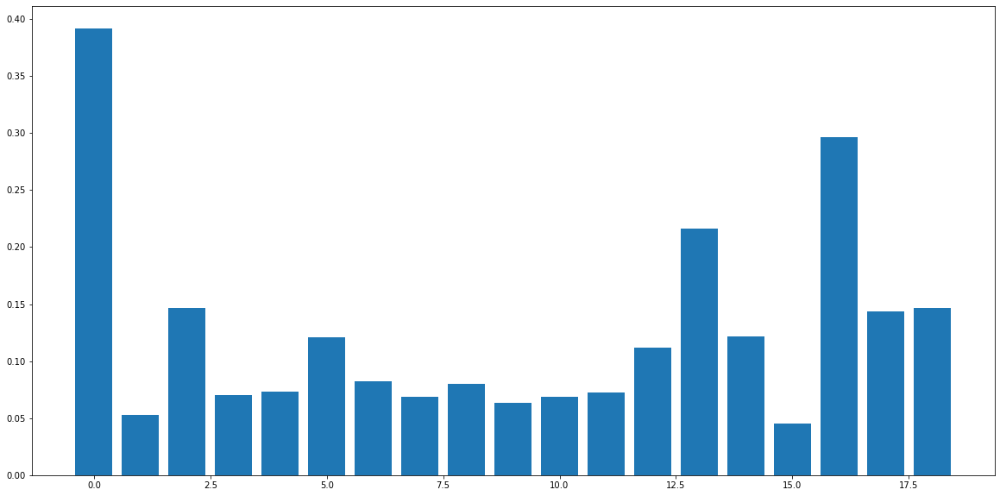

In [42]:
class_means = AVG_LOGITS.mean(dim=0).numpy()
labels = range(19)
plt.bar(labels, class_means)
plt.show()

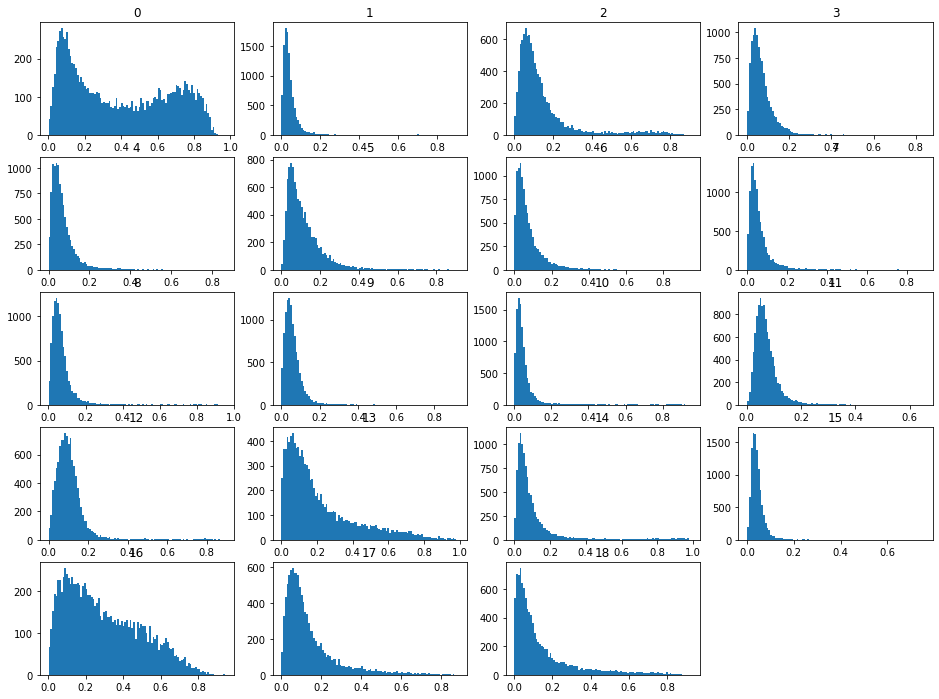

In [43]:
fig = plt.figure(figsize=(16, 12))

for i in labels:
    ax = fig.add_subplot(5,4,i+1)
    ax.hist(AVG_LOGITS[:,i].numpy(), bins=100)
    ax.set_title(i)

plt.show()

In [44]:
top_preds = AVG_LOGITS.argmax(dim=0).tolist()
top_kpreds = (-AVG_LOGITS).argsort(dim=0)[:6]
top30preds = (-AVG_LOGITS).argsort(dim=0)[30:33]
last_preds = (-AVG_LOGITS).argsort(dim=0)[-3:]
othe_preds = torch.cat([top30preds, last_preds], dim=0)
top_kvals = [[AVG_LOGITS[top_kpreds[i,j],j] for i in range(6)] for j in range(19)]
othe_vals = [[AVG_LOGITS[othe_preds[i,j],j] for i in range(6)] for j in range(19)]

In [45]:
HPA_LABEL_NAMES = {
    0: 'Nucleoplasm',
    1: 'Nuclear membrane',
    2: 'Nucleoli',
    3: 'Nucleoli fibrillar center',
    4: 'Nuclear speckles',
    5: 'Nuclear bodies',
    6: 'Endoplasmic reticulum',
    7: 'Golgi apparatus',
    8: 'Intermediate filaments',
    9: 'Actin filaments',
    10: 'Microtubules',
    11: 'Mitotic spindle',
    12: 'Centrosome',
    13: 'Plasma membrane',
    14: 'Mitochondria',
    15: 'Aggresome',
    16: 'Cytosol',
    17: 'Vesicles and punctate cytosolic patterns',
    18: 'Negative'
}

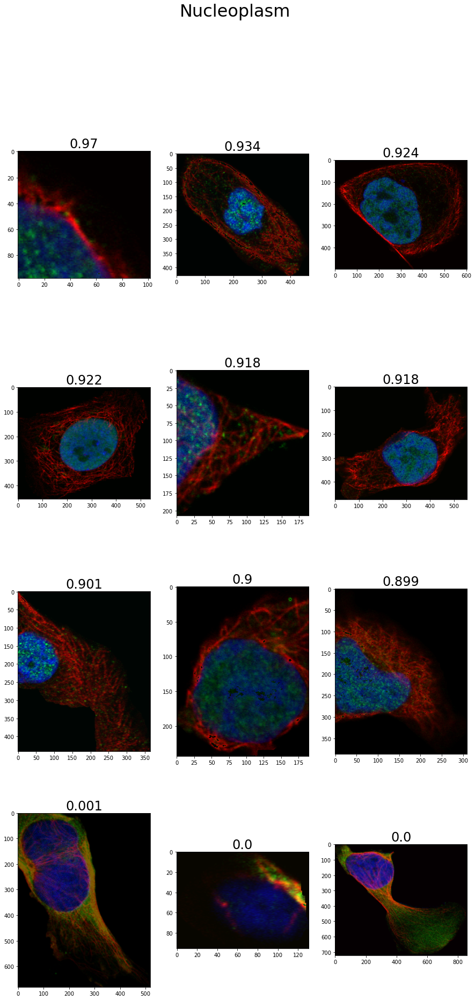

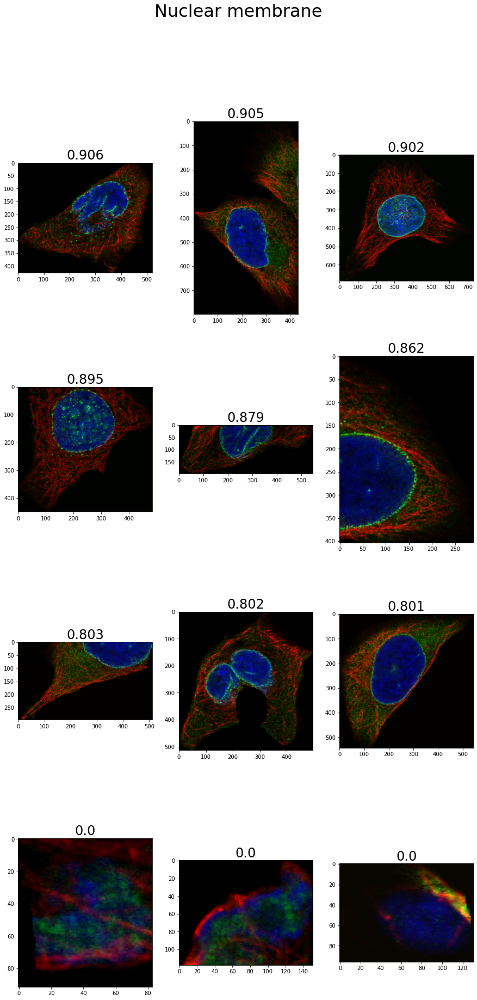

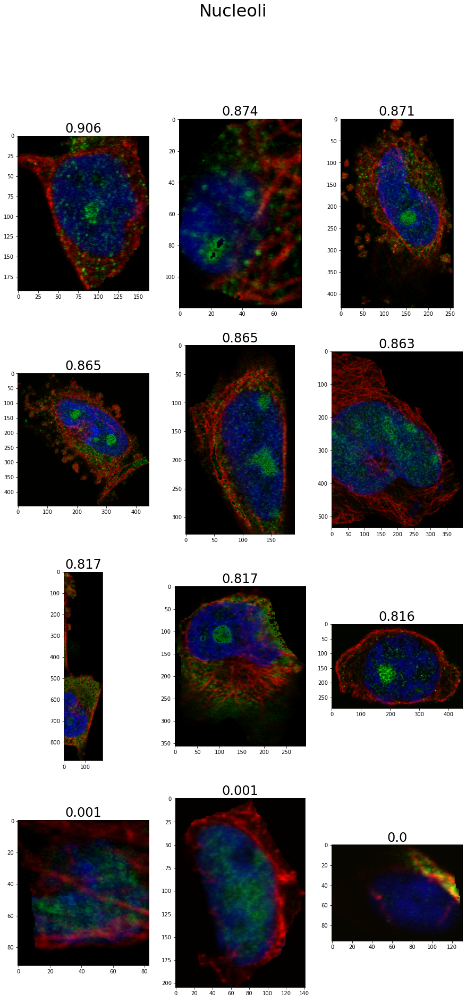

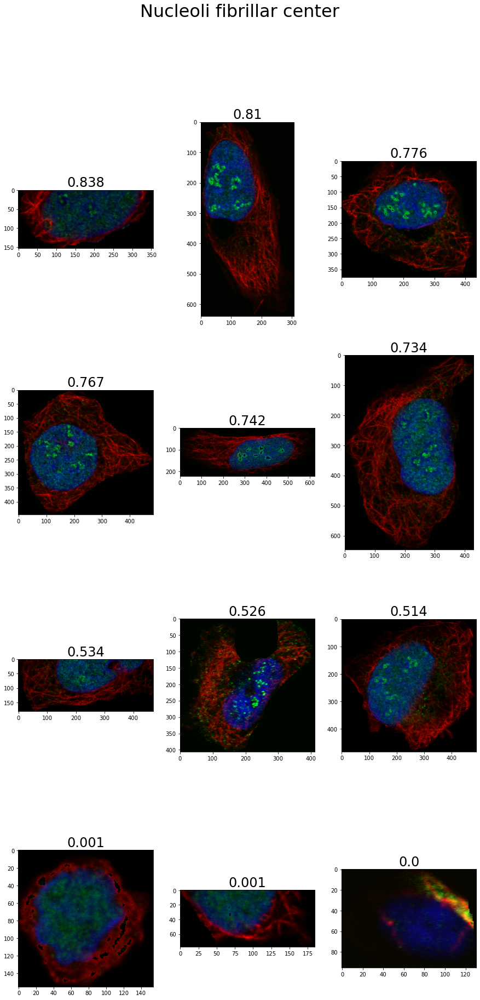

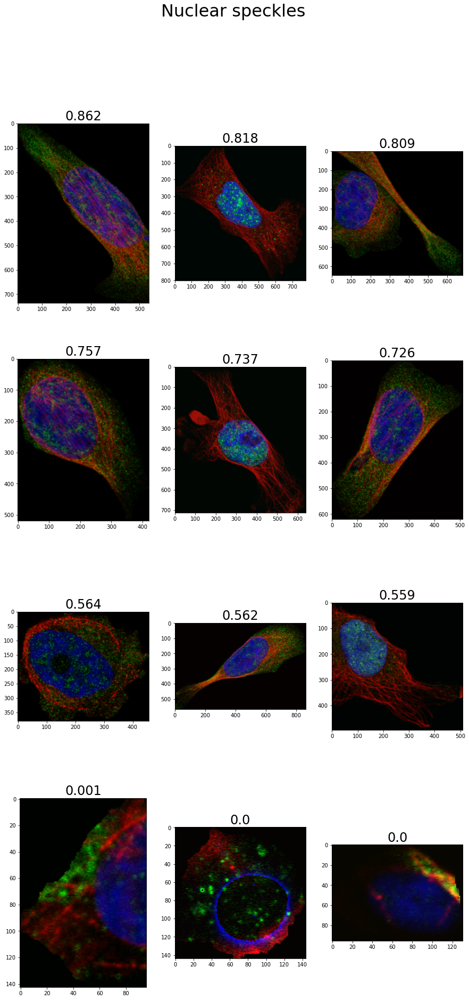

...

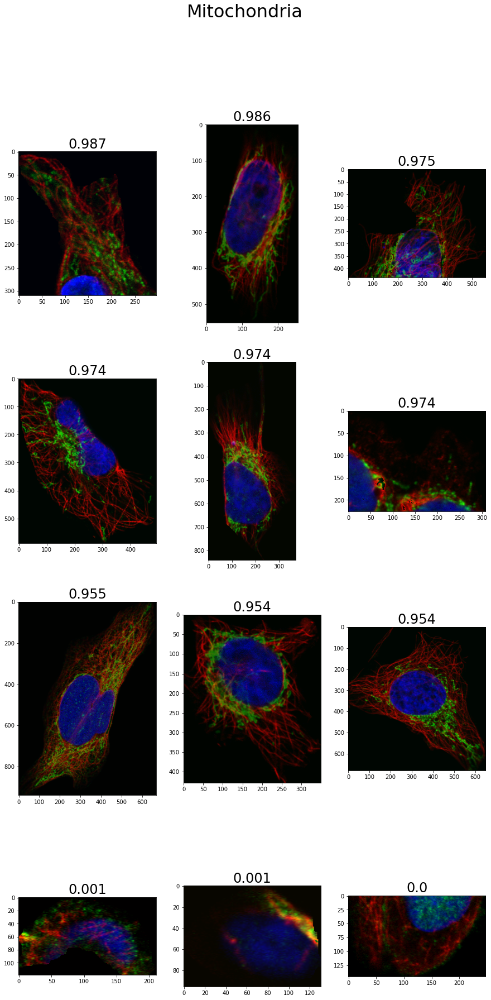

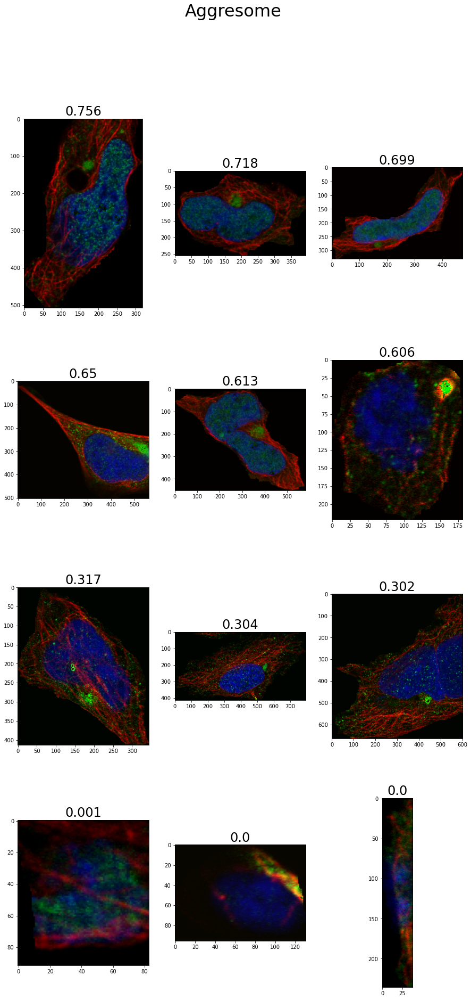

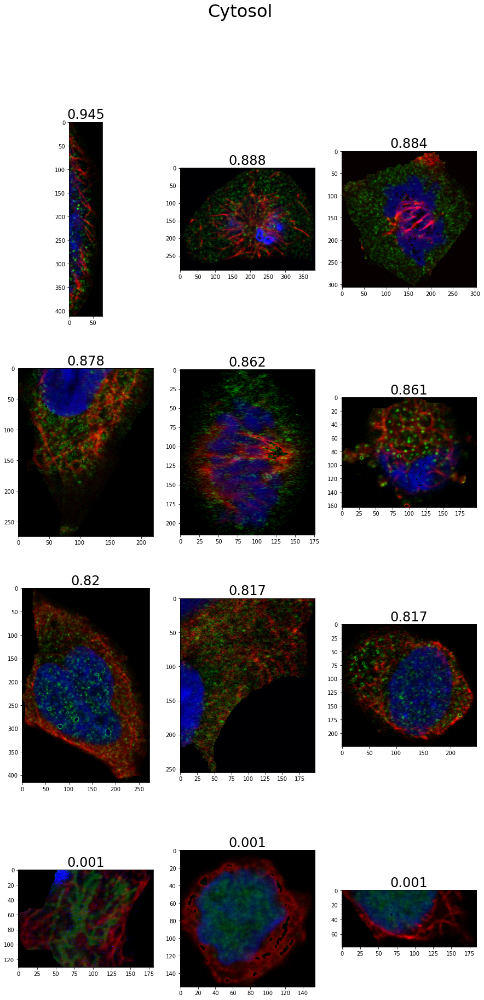

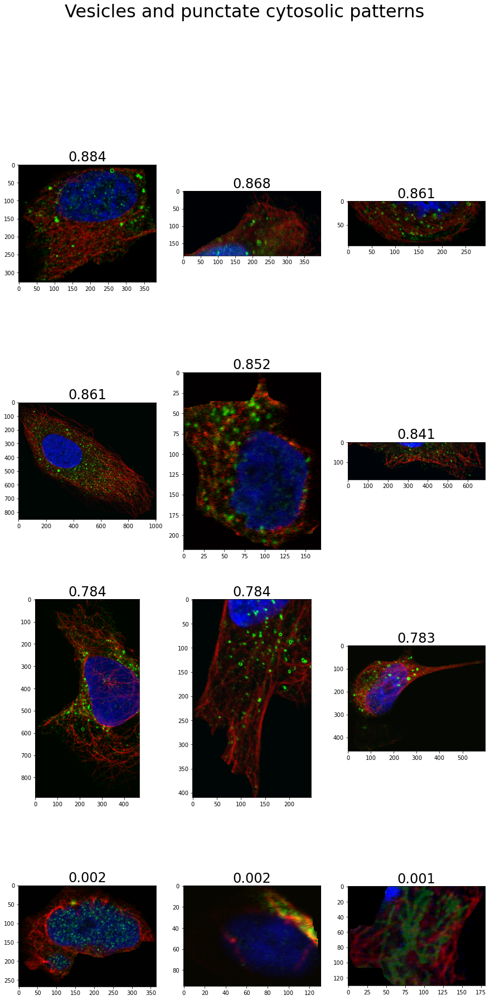

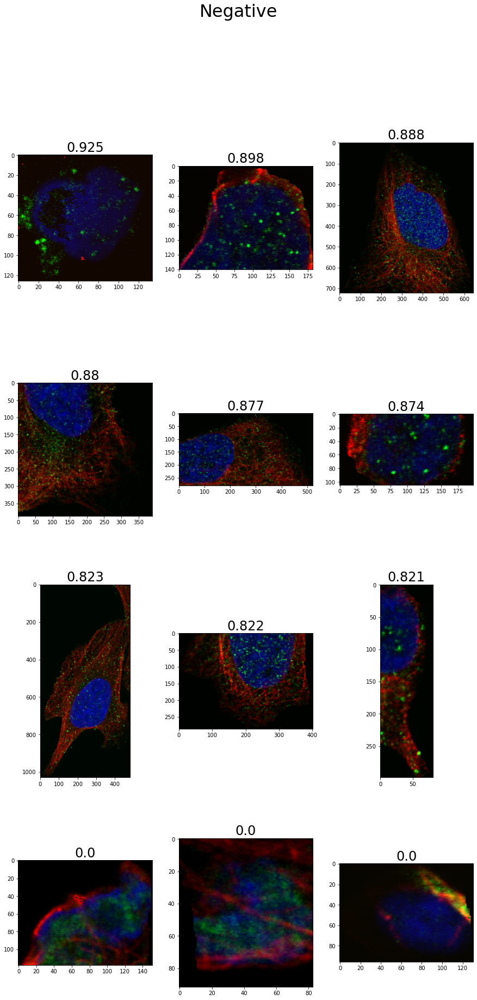

In [46]:
dataset_show = HPATestDataset(test_df, transform=None)
from pylab import rcParams
rcParams['figure.figsize'] = 15,30
rcParams['figure.titlesize'] = 32
rcParams['axes.titlesize'] = 24
rcParams['axes.labelsize'] = 20

for i in range(19):
    f, axarr = plt.subplots(4,3)
    f.suptitle(f'{HPA_LABEL_NAMES[i]}')
    for p in range(3):
        idx = top_kpreds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[0,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[0,p].title.set_text(f'{np.round(top_kvals[i][p].item(), 3)}')
    for p in range(3):
        idx = top_kpreds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[1,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[1,p].title.set_text(f'{np.round(top_kvals[i][p+3].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[2,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[2,p].title.set_text(f'{np.round(othe_vals[i][p].item(), 3)}')
    for p in range(3):
        idx = othe_preds[p+3,i].item()
        img = dataset_show[idx][:3]
        img = unnorm(img)
        axarr[3,p].imshow(img.transpose(0, 1).transpose(1,2).squeeze())
        axarr[3,p].title.set_text(f'{np.round(othe_vals[i][p+3].item(), 3)}')